<a href="https://colab.research.google.com/github/RTallman/BCS_109/blob/master/Australia_Weather.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Australia Weather: When it rains
**By: Jake Sokol, Rebecca Tallman, Sean Ramos**

**Australia** is a very large country/continent and surrounded by water. Due to its large size, it is easy to assume that the different areas could experience vastly different weather occurances. In fact, the areas are divided into six different climate zones. The dataset below takes aim at the rainfall around the country as well as the elements occuring at the same instances of data recording. Australia has several different climate zones. The northern section experiences more of a tropical climate, with humid and hot temperatures during the summer and warm dry winters. The southern portions of Australia generally deal wuth a more temperate to warm summer and cooler winters. Uncomparable is the desert and brush areas in the Outback of Australia, the center of the landmass. Rain may not fall for years in this area but rain down constantly in the tropical areas. The north can experience tropical cyclones and the south has been met with extratropical storms at times, while the Outback remains arid.

# Import Data

Our data set is based on the weather in Australia, specifically focusing on data pertaining to rain fall and the weather conditions surrounding the events. This data set contains categorial, numeric, and null values. During the importation of the data we imported our libraries, named our columns, imported the file, dropped the original headers so our predetermined column names would be used, created a backup copy incase of any mistakes and checked the dimensions of the data. This data set contains points from daily weather observations over a 10 year period, accoss various weather stations in Australia.

**The data**

text

In [24]:
#https://raw.githubusercontent.com/RTallman/BCS_109/master/weatherAUS.csv
#https://www.kaggle.com/jsphyg/weather-dataset-rattle-package
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns

column_names = ['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall',	'Evaporation',	'Sunshine',	'WindGustDir,'	'WindGustSpeed',	'WindDir9am',	'WindDir3pm',	'WindSpeed9am',	'WindSpeed3pm',	'Humidity9am',	'Humidity3pm',	'Pressure9am',	'Pressure3pm',	'Cloud9am',	'Cloud3pm',	'Temp9am',	'Temp3pm',	'RainToday',	'RISK_MM',	'RainTomorrow']

#import data
df = pd.read_csv("https://raw.githubusercontent.com/RTallman/BCS_109/master/weatherAUS.csv", engine="python")

#drop the original headers become the first row
df = df.drop(0)

#create second copy
df_original = df

#check dimensions of data
print('The dimensions of the data are: ', df.shape)

#show the beginning of data
df.head()

The dimensions of the data are:  (142192, 24)


,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No
5,2008-12-06,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,19.0,24.0,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,0.0,No


We checked for empty data inorder to see if we were missing any values. This is important as it could impede our data and give errors throughout the project.

In [25]:
#Check for empty data
df.isna().sum()

Date                 0
Location             0
MinTemp            637
MaxTemp            322
Rainfall          1406
Evaporation      60842
Sunshine         67815
WindGustDir       9330
WindGustSpeed     9270
WindDir9am       10013
WindDir3pm        3778
WindSpeed9am      1348
WindSpeed3pm      2630
Humidity9am       1774
Humidity3pm       3610
Pressure9am      14014
Pressure3pm      13981
Cloud9am         53657
Cloud3pm         57093
Temp9am            904
Temp3pm           2726
RainToday         1406
RISK_MM              0
RainTomorrow         0
dtype: int64

If all values are the same then our analysis and graphs would not present enough imagery or information to address questions. In order to avoid this and provide a better understanding of the data set, we checked for unique values below.

In [26]:
#Check for unique data
df.nunique()

Date             3436
Location           49
MinTemp           389
MaxTemp           505
Rainfall          679
Evaporation       356
Sunshine          145
WindGustDir        16
WindGustSpeed      67
WindDir9am         16
WindDir3pm         16
WindSpeed9am       43
WindSpeed3pm       44
Humidity9am       101
Humidity3pm       101
Pressure9am       546
Pressure3pm       549
Cloud9am           10
Cloud3pm           10
Temp9am           440
Temp3pm           500
RainToday           2
RISK_MM           681
RainTomorrow        2
dtype: int64

This analysis displays that RainToday and RainTomorrow have limited data differences. They may not be applicable to our project and are potentially removable. We will leave them for now just in case.

A piece of categorical data that could provide a predictive element in the future is 'Location'. The data explains the different areas where rainfall is being analyzed. We may be able to predict a certain rainfall in a particular area. Below is a break down of the values taken from which locations.

In [27]:
#output the individual parts of the categorical data to view it
print(df['Location'].value_counts())

Canberra            3418
Sydney              3337
Perth               3193
Darwin              3192
Hobart              3188
Brisbane            3161
Adelaide            3090
Bendigo             3034
Townsville          3033
AliceSprings        3031
MountGambier        3030
Ballarat            3028
Launceston          3028
Albany              3016
Albury              3010
MelbourneAirport    3009
PerthAirport        3009
Mildura             3007
SydneyAirport       3005
Nuriootpa           3002
Sale                3000
Watsonia            2999
Tuggeranong         2998
Portland            2996
Woomera             2990
Cobar               2988
Cairns              2988
Wollongong          2983
GoldCoast           2980
WaggaWagga          2976
NorfolkIsland       2964
Penrith             2964
Newcastle           2955
SalmonGums          2955
CoffsHarbour        2953
Witchcliffe         2952
Richmond            2951
Dartmoor            2943
NorahHead           2929
BadgerysCreek       2928


It is important to obtain a descrption of our data inorder to recieve statistics about our numeric data. This feature also summerizes the data statistics to make them more manageable. Below are the counts, means, standard deviations, minimums, maximums and quarterly readings of our data sets. 

In [28]:
#Describe data to receive information about statistics and nonnull data
#only reports numeric columns
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM
count,141555.000000,141870.000000,140786.000000,81350.000000,74377.000000,132922.000000,140844.000000,139562.000000,140418.000000,138582.000000,128178.000000,128211.000000,88535.000000,85099.000000,141288.000000,139466.000000,142192.000000
mean,12.186391,23.226786,2.349987,5.469824,7.624853,39.984261,14.001945,18.637537,68.843795,51.482819,1017.653836,1015.258267,4.437149,4.503167,16.987509,21.687234,2.360698
std,6.403304,7.117643,8.465202,4.188537,3.781525,13.588847,8.893354,8.803365,19.051360,20.797696,7.105449,7.036667,2.887007,2.720633,6.492861,6.937619,8.477997
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.500000,977.100000,0.000000,0.000000,-7.200000,-5.400000,0.000000
25%,7.600000,17.900000,0.000000,2.600000,4.900000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.900000,1010.400000,1.000000,2.000000,12.300000,16.600000,0.000000
50%,12.000000,22.600000,0.000000,4.800000,8.500000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.600000,1015.200000,5.000000,5.000000,16.700000,21.100000,0.000000
75%,16.800000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.400000,1020.000000,7.000000,7.000000,21.600000,26.400000,0.800000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.000000,1039.600000,9.000000,9.000000,40.200000,46.700000,371.000000


The maximum temperature for the minimum temperature readings is 33.9 degrees celcius while the minimum temperature for the maximum temperature readings is -4.8 degrees celcius. The counts helps us see that there were a very similar number of readings taken. For example, MinTemp, MaxTemp and Rainfall have very similar counts. The more comparable data points there are, the more confidence in inferences that are made based on these data points there can be. 

# Getting report
The pandas libray, profile report feature, is a great way to break down and output an exploratory data analysis. It provides the types of columns within the dataframe, shows types, unique values, as well as missing values. It also provides quantile statistics, most frequent values, a histogram which shows numerical data by range of value, and highly correlated variables. There is also text analysis and file and image analysis, if needed.


In [29]:
!pip install pandas_profiling --upgrade

Requirement already up-to-date: pandas_profiling in /usr/local/lib/python3.6/dist-packages (2.9.0)


The variable types are important to help keep track of how many different types we have and how many of each type are present. There are 18 numeric types, 5 categorical data types and 2 booleans. The data was determined to be unique and 100% distinct. The categorical data is very distinct and has high cardinality, showing that even our categorical data is unique. The Minimum Temperature readings have a high correlation and give the minimum, MinTemp as -8.5 degrees Celcius and the maximum, MinTemp as 33.9 degrees Celcius. This coinsides with our earlier analysis. The MaxTemp minimum reading was -4.9 degrees Celcius and the maximum, MaxTemp was 48.1 degrees Celcius. The maximum amount of Rainfall was 371mm and the readings did include 0s as some areas experience no rainfall for that day. There are some missing data points in the Evaporation category as without rainfall their is no evaporation to measure. 

In the graphing section of the report lies the correlation matrix. It gives  detailed imagery to help compare the variables. For example, on hotter days, when there was less rainfall. Pressure readings, do not have much similarity to other readings based on the correlation matrix but nothing is a deeper color red than when comparing sunshine variables to cloud variables as clouds in the sky would limit the sunrays that are being emitted.

In [30]:
import pandas_profiling
pandas_profiling.ProfileReport(df)

# Check Categorical Data

**Question #1:** Which way does the wind predominantly blow in Australia?

While our categorical data, does not give numeric values, it can be helpful in identifying the occurances of each piece of data. The Wind Gust Direction value counts show that the wind in Australia predominantly blows west, south east, east and north. This is important for predicting weather patterns and global climate. As different wind patterns can affect rates of evaporation, misture of surface waters and the development of storm surges.

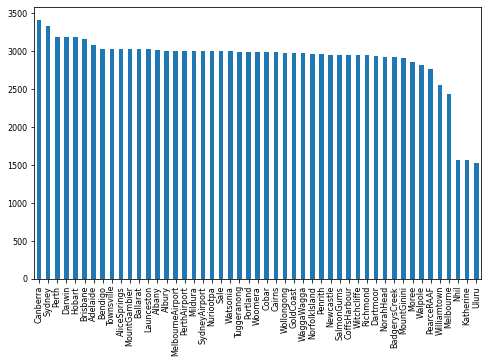

In [31]:
#use of value_counts to plot different locations
#This output shows how many readings were taken from each location
#It helps confirm that a decent amount of data has been recorded from each location
#3 locations show significantly less data points and could lead the observer to determine that there is less wind in those areas
plt.figure(figsize=(8,5))
df['Location'].value_counts().plot(kind='bar', fontsize = 8)

In [32]:
#output the individual parts of the categorical data to view it
print(df['WindGustDir'].value_counts())

W      9779
SE     9309
E      9071
N      9033
SSE    8993
S      8949
WSW    8901
SW     8797
SSW    8610
WNW    8066
NW     8003
ENE    7992
ESE    7305
NE     7060
NNW    6561
NNE    6433
Name: WindGustDir, dtype: int64


In [33]:
#output the individual parts of the categorical data to view it
print(df['WindDir9am'].value_counts())

N      11393
SE      9162
E       9024
SSE     8966
NW      8552
S       8493
W       8259
SW      8237
NNE     7948
NNW     7840
ENE     7735
ESE     7558
NE      7527
SSW     7448
WNW     7194
WSW     6843
Name: WindDir9am, dtype: int64


In [34]:
#output the individual parts of the categorical data to view it
print(df['WindDir3pm'].value_counts())

SE     10663
W       9911
S       9598
WSW     9329
SW      9182
SSE     9142
N       8667
WNW     8655
NW      8468
ESE     8382
E       8342
NE      8164
SSW     8010
NNW     7733
ENE     7724
NNE     6444
Name: WindDir3pm, dtype: int64


**Findings**

Furthermore, a closer look at which direction the wind is blowing at which time of the day can help plan out the day. At 9am, the wind blows mainly towards the North, while at 3pm, it primarily heads to the south east. Knowing the common flow of wind can aid in many areas. If a storm is headed in, different areas can adjust to batten down and protect their properties. If a wildfire is raging, like we saw recently, authorities can use a wind record like we have created to hypothesize which direction the wind is most like to go and put resources in place to stop the spread of the fire.

# Analyze non-categorical data

In [35]:
#remove column name
numerical_columns = column_names.remove('Location')

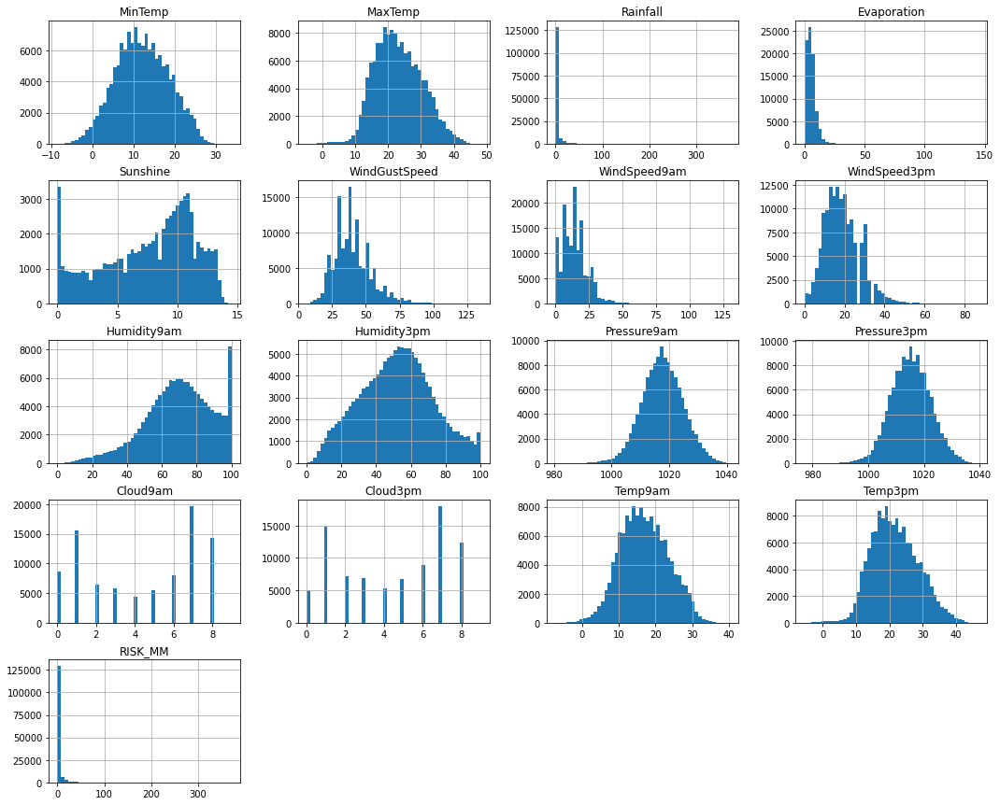

In [36]:
#Histogram this houses only our numerical data
dfNumerical = df

dfNumerical.hist(bins = 50, figsize = (18 , 15))
plt.show()

The above data shows the numerical information in our data set. It shows highs and lows of different elements and is especially useful in analyzing. It shows consistancies and pitches in data. For example, the pressure remained consistant throughout the day, 9am and 3pm, however the humdity decreased from 6000 to 5000 at the same times. 

# Correlation Matrix

**Question 2** How do the different elements effect each other?



The correlation matrix displays the similarities and differences between pairs of variables. 

**Findings**

The minimum temperature has a high correlation with the temperature taken at 9am and as expected the max temperature's highest relationship is with the temperature taken at 3pm when the sun is most likely at its highest point in the sky. 

The cloud reading has a very distant relationship with the sunshine element as they interfere with each other in the sky. 

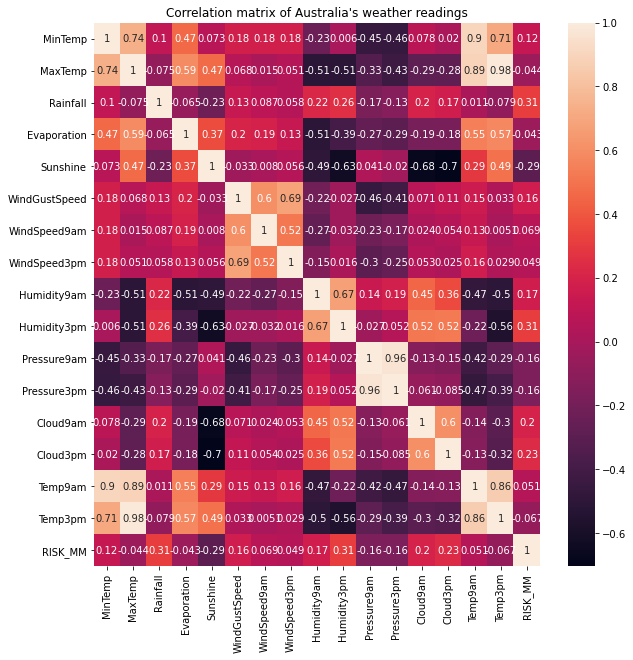

In [37]:
#Correlation matrix
corrMatrix = df.corr()
plt.figure(figsize=(10,10))
sns.heatmap(corrMatrix, annot=True)
plt.title("Correlation matrix of Australia's weather readings")

plt.show()

In [38]:
#Matrix correlations listed in ascending order
corrMatrix["MinTemp"].sort_values(ascending=False)

MinTemp          1.000000
Temp9am          0.901813
MaxTemp          0.736268
Temp3pm          0.708865
Evaporation      0.467261
WindGustSpeed    0.177285
WindSpeed9am     0.176005
WindSpeed3pm     0.175749
RISK_MM          0.124744
Rainfall         0.104255
Cloud9am         0.077625
Sunshine         0.072961
Cloud3pm         0.020489
Humidity3pm      0.006001
Humidity9am     -0.234211
Pressure9am     -0.451262
Pressure3pm     -0.461624
Name: MinTemp, dtype: float64

The matrix correlation below shows a breakdown of less elements. 

**Question #3** Is the minimum temperature more likely to occur at the Temp9am reading ?

**Findings**

Yes, there appears to be a correlation between the minimum temperature and temperature readings from 9am, Based on the scatter temperature below. This can help predict what activites someone should do at what time of the day. If someone needs to do strenous, outdoor activities, it would be healthier to do them in cooler temperatures, thus the morning, would be a better time to perform their duties.

/usr/local/lib/python3.6/dist-packages/matplotlib/collections.py:885: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


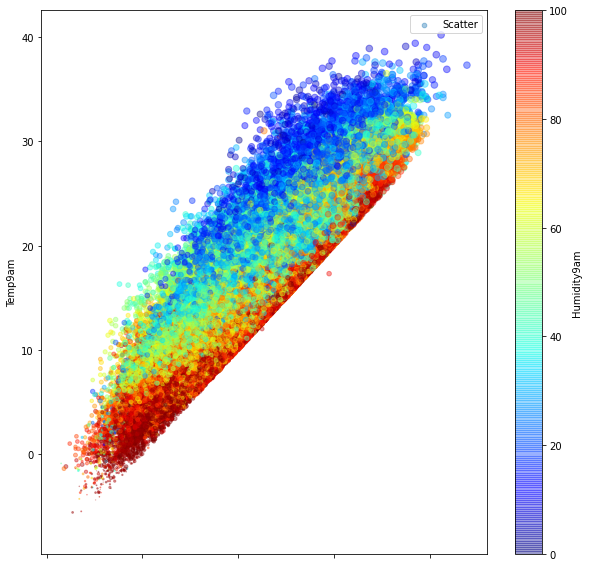

In [39]:
#individual comparisons
#s is circle size
#c is the color

df.plot(kind="scatter", x="MinTemp", y="Temp9am", alpha=.4, s=df["MaxTemp"], label="Scatter", figsize=(10,10), c="Humidity9am", cmap=plt.get_cmap("jet"), colorbar=True,)
plt.legend()

A scatter matrix is used to visualize bivariate relationships between combinations of variables. When the points form a pattern, a correlation is being displayed. When it displays a blob, there is no correlation. 

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fd66b5c8be0>,
      dtype=object)

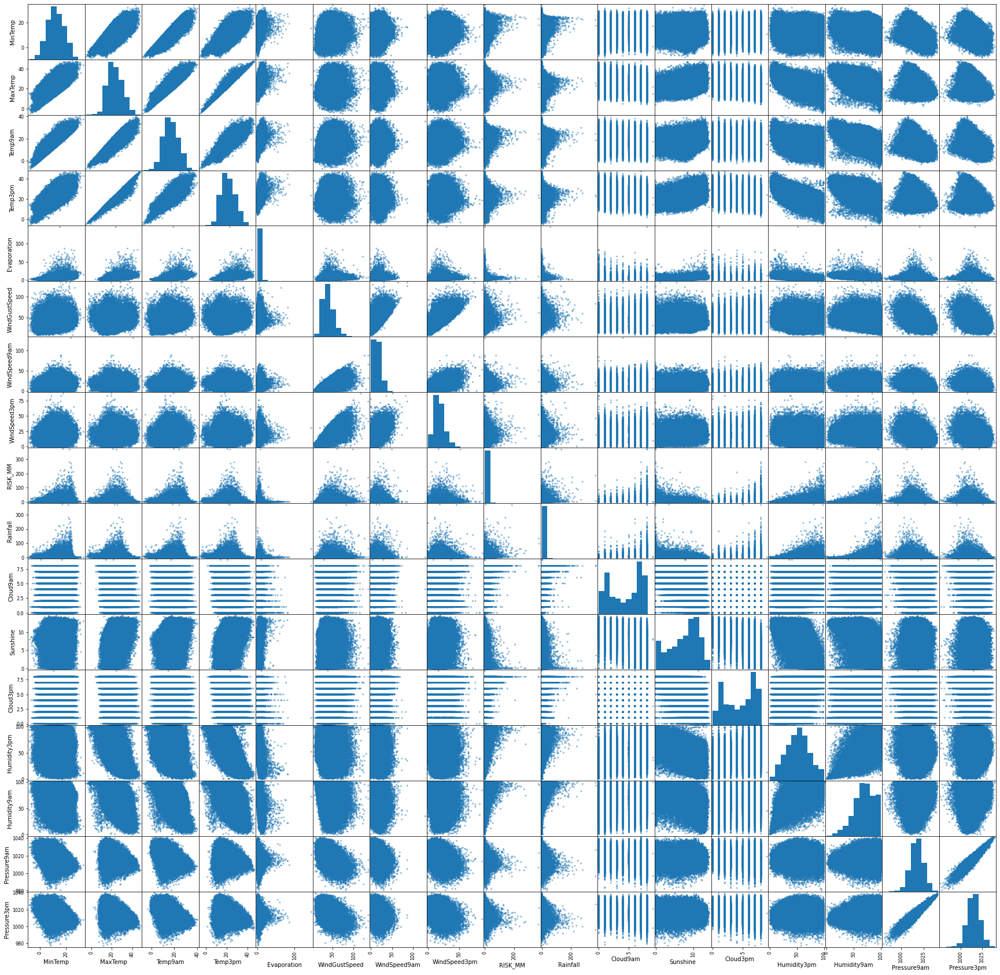

In [40]:
#compare attributes
#missing anything in a non-linear relationship?
from pandas.plotting import scatter_matrix

attributes = ['MinTemp', 'MaxTemp', 'Temp9am', 'Temp3pm', 'Evaporation', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'RISK_MM', 'Rainfall', 'Cloud9am', 'Sunshine', 'Cloud3pm', 'Humidity3pm', 'Humidity9am', 'Pressure9am', 'Pressure3pm']
scatter_matrix(df[attributes], figsize=(30, 30))

Due to a scatter matrix of all elements being a bit overwhelming to read, we have broken it down to examine the temperature readings taken at 9am and 3pm. These variables have been our focus as they can help predict how the afternoon may be temperature wise based on the history of morning and afternoon temperatures before it.

This matrix shows that the temperature usually increases throughout the day.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fd66ef79f98>,
      dtype=object)

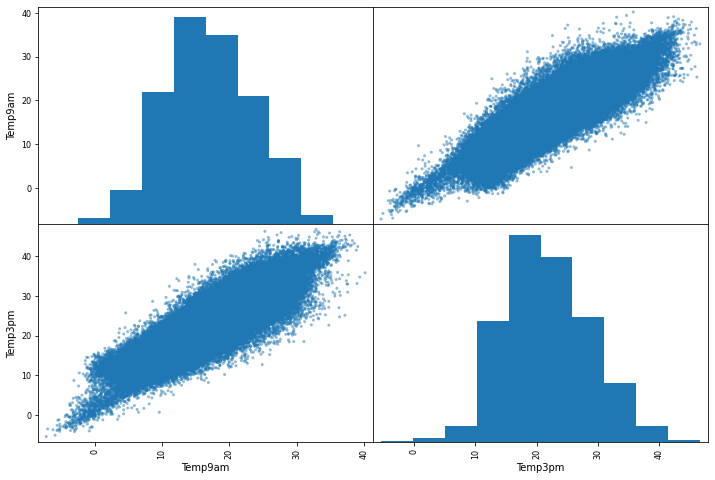

In [41]:
from pandas.plotting import scatter_matrix

attributes = ['Temp9am', 'Temp3pm']
scatter_matrix(df[attributes], figsize=(12, 8))

The scatter matrix below shows a correlation between rainfall and humidity and that when rainfall is low, evaporation is high. Evaporation datas also correlate with humidity but taper off and evaporation levels out.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fd66ef9d0b8>,
      dtype=object)

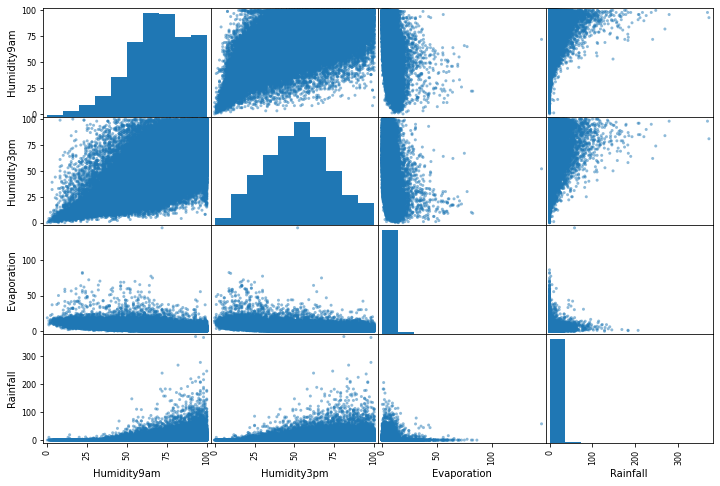

In [42]:
from pandas.plotting import scatter_matrix

attributes = ['Humidity9am', 'Humidity3pm', 'Evaporation', 'Rainfall']
scatter_matrix(df[attributes], figsize=(12, 8))

This scatter matrix shows that pressure does not correlate well with humidity, however, with evaporation and rainfall, it forms a peak, showing that they effect each other.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fd66e4e2358>,
      dtype=object)

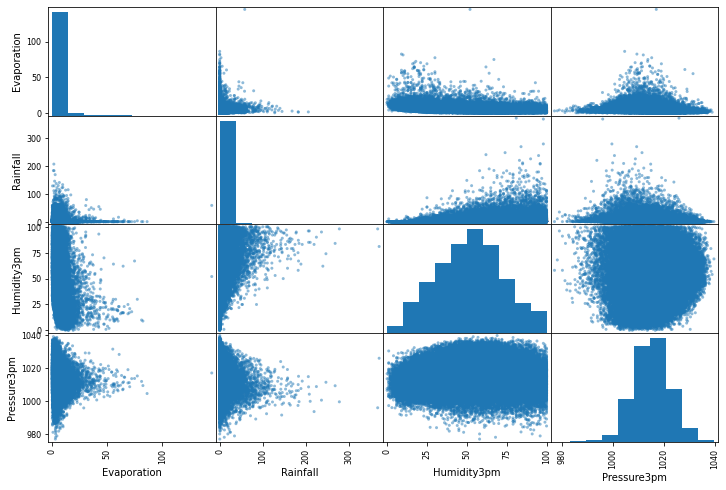

In [43]:
#scatter matrix
from pandas.plotting import scatter_matrix

attributes = ['Evaporation', 'Rainfall', 'Humidity3pm', 'Pressure3pm']
scatter_matrix(df[attributes], figsize=(12, 8))

# Missing Data?
It is important to check for missing data and find the correct way to deal with it. There are several ways, such as to elminate the entire row, get rid of the attribute or to set the values to zero. Setting the values to 0, give a numerical value to the empty data. 

In [44]:
#Checking for missing data
df.isna().sum()

Date                 0
Location             0
MinTemp            637
MaxTemp            322
Rainfall          1406
Evaporation      60842
Sunshine         67815
WindGustDir       9330
WindGustSpeed     9270
WindDir9am       10013
WindDir3pm        3778
WindSpeed9am      1348
WindSpeed3pm      2630
Humidity9am       1774
Humidity3pm       3610
Pressure9am      14014
Pressure3pm      13981
Cloud9am         53657
Cloud3pm         57093
Temp9am            904
Temp3pm           2726
RainToday         1406
RISK_MM              0
RainTomorrow         0
dtype: int64

There are some missing data points in our dataframe.

In [45]:
#check variable type of each item

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 142192 entries, 1 to 142192
Data columns (total 24 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           142192 non-null  object 
 1   Location       142192 non-null  object 
 2   MinTemp        141555 non-null  float64
 3   MaxTemp        141870 non-null  float64
 4   Rainfall       140786 non-null  float64
 5   Evaporation    81350 non-null   float64
 6   Sunshine       74377 non-null   float64
 7   WindGustDir    132862 non-null  object 
 8   WindGustSpeed  132922 non-null  float64
 9   WindDir9am     132179 non-null  object 
 10  WindDir3pm     138414 non-null  object 
 11  WindSpeed9am   140844 non-null  float64
 12  WindSpeed3pm   139562 non-null  float64
 13  Humidity9am    140418 non-null  float64
 14  Humidity3pm    138582 non-null  float64
 15  Pressure9am    128178 non-null  float64
 16  Pressure3pm    128211 non-null  float64
 17  Cloud9am       88535 non-null

Impute data: Below are the steps it impute our data and fix our missing data points. 

In [46]:
def simple_imputer(data,columns):
    
    for col in columns:
        total_nan=int(data[col].isnull().sum())
        
        if(col in categorical_columns):
            
            most_frequent_value=data[col].value_counts().index[0]
            data[col]=data[col].fillna(most_frequent_value)
            
            print("A total of {} Categorical variable {} have been imputed.".format(total_nan,col))
            
        else:
            mean=data[col].mean()
            std=data[col].std()
            
            random_normal=np.random.normal(loc=mean,scale=std,size=total_nan) 
            data[col][data[col].isnull()]=random_normal
            
            print("A total of {} Numerical variable {} have been imputed.".format(total_nan,col))

In [47]:
#Imputing
from sklearn.impute import SimpleImputer

#create a second data set to test it on
df_SI = df.copy()

#drop the categorical data so that the Imputer will work right
#Regression
df_SI.drop(['Location', 'Date', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow'], axis = 1, inplace=True)

#call the imputer with the strategy you want
imp = SimpleImputer(missing_values = np.nan, strategy='median')

#note that SimpleImputer returns a numpy array, which is not what I want
#I fit it into a dataframe, but have to reassign the names and put back the location column
df_SI = pd.DataFrame(imp.fit_transform(df_SI))

#replace the column names using the previously made list called column_names
SI_columns = ['MinTemp', 'MaxTemp', 'Rainfall',	'Evaporation',	'Sunshine',	'WindGustSpeed',	'WindSpeed9am',	'WindSpeed3pm',	'Humidity9am',	'Humidity3pm',	'Pressure9am',	'Pressure3pm',	'Cloud9am',	'Cloud3pm',	'Temp9am',	'Temp3pm',	'RISK_MM']
df_SI.columns = SI_columns

#after testing this, I noticed that my df_SI index starts from 0 and not 1
#this is messing up when I try and put 'location' back with the data, since its index starts from 1
#so I increment the index and only then add the column back in
df_SI.index += 1

#add the date column back in
df_SI['Date'] = df['Date']

#check that it all worked
df_SI.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM,Date
1,7.4,25.1,0.0,4.8,8.5,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0.0,2008-12-02
2,12.9,25.7,0.0,4.8,8.5,46.0,19.0,26.0,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0.0,2008-12-03
3,9.2,28.0,0.0,4.8,8.5,24.0,11.0,9.0,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,1.0,2008-12-04
4,17.5,32.3,1.0,4.8,8.5,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.2,2008-12-05
5,14.6,29.7,0.2,4.8,8.5,56.0,19.0,24.0,55.0,23.0,1009.2,1005.4,5.0,5.0,20.6,28.9,0.0,2008-12-06


In [48]:
df_SI['Date'] = df['Date'].apply(lambda x: x[0:4])

We have dropped some categorical data, and replaced missing data with 0s.

# Scaling 
With scaling we are able to compare numeric data in a way similar to comparing apples to apples. This process shows us that the cloud readings at 9am and 3pm are very consistant as well as the temperatures at 9am. The temperature readings at 3pm and the Max temperatures are less consistant, which could be because the sunshine readins and wind variables vary more.

In [49]:
#scaling
from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(df_SI)
df_scaled = pd.DataFrame(x_scaled)
df_scaled.columns = (['Date', 'MinTemp', 'MaxTemp', 'Rainfall',	'Evaporation',	'Sunshine',	'WindGustSpeed',	'WindSpeed9am',	'WindSpeed3pm',	'Humidity9am',	'Humidity3pm',	'Pressure9am',	'Pressure3pm',	'Cloud9am',	'Cloud3pm',	'Temp9am',	'Temp3pm',	'RISK_MM'])
df_scaled.head()


,Date,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM
0,0.375000,0.565217,0.000000,0.033103,0.586207,0.294574,0.030769,0.252874,0.44,0.25,0.497521,0.4912,0.555556,0.555556,0.514768,0.570058,0.000000,0.1
1,0.504717,0.576560,0.000000,0.033103,0.586207,0.310078,0.146154,0.298851,0.38,0.30,0.447934,0.5056,0.555556,0.222222,0.594937,0.548944,0.000000,0.1
2,0.417453,0.620038,0.000000,0.033103,0.586207,0.139535,0.084615,0.103448,0.45,0.16,0.613223,0.5712,0.555556,0.555556,0.533755,0.612284,0.002695,0.1
3,0.613208,0.701323,0.002695,0.033103,0.586207,0.271318,0.053846,0.229885,0.82,0.33,0.500826,0.4624,0.777778,0.888889,0.527426,0.673704,0.000539,0.1
4,0.544811,0.652174,0.000539,0.033103,0.586207,0.387597,0.146154,0.275862,0.55,0.23,0.474380,0.4528,0.555556,0.555556,0.586498,0.658349,0.000000,0.1


# Label Encoder
The label encoder process allows use to change the date categorical data into 
useful numerical values, for analyzing differences in weather patterns on different dates.

Some variables (WindGustDir, WindDir9am, WindDir3pm) may need to be dropped.


In [50]:
from sklearn import preprocessing

#set up LabelEncoding
le = preprocessing.LabelEncoder()
interim = le.fit_transform(df_SI['Date'])

#place it back into a dataframe
interim = pd.DataFrame(interim)
interim.columns = ['Date']

#place the new values back in df_SI
df_SI['Date'] = interim['Date']

#check
df_SI.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM,Date
1,7.4,25.1,0.0,4.8,8.5,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0.0,1.0
2,12.9,25.7,0.0,4.8,8.5,46.0,19.0,26.0,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0.0,1.0
3,9.2,28.0,0.0,4.8,8.5,24.0,11.0,9.0,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,1.0,1.0
4,17.5,32.3,1.0,4.8,8.5,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.2,1.0
5,14.6,29.7,0.2,4.8,8.5,56.0,19.0,24.0,55.0,23.0,1009.2,1005.4,5.0,5.0,20.6,28.9,0.0,1.0


# Linear regression model

This is a statistical approach for modeling relationships between a dependent variable and a set of independent variables. 

In [51]:
from sklearn.linear_model import LinearRegression

#take out RISK_MM, because that is what we are going to be studying
y = df_scaled['RISK_MM'].copy()
X = df_scaled.drop(['RISK_MM'], axis = 1)

lin_reg = LinearRegression().fit(X,y)
r_sq = lin_reg.score(X, y)

print(r_sq)

0.02562591810850723


Regressions with statistics: The below table is a comprehensible composition of the linear regression. It is summary.

In [52]:
import statsmodels.api as sm
#Regression with statistics
model = sm.OLS(y, X)
results = model.fit()
print(results.summary())



/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


                                 OLS Regression Results                                
Dep. Variable:                RISK_MM   R-squared (uncentered):                   0.841
Model:                            OLS   Adj. R-squared (uncentered):              0.841
Method:                 Least Squares   F-statistic:                          4.416e+04
Date:                Wed, 16 Dec 2020   Prob (F-statistic):                        0.00
Time:                        21:06:40   Log-Likelihood:                         -5309.0
No. Observations:              142192   AIC:                                  1.065e+04
Df Residuals:                  142175   BIC:                                  1.082e+04
Df Model:                          17                                                  
Covariance Type:            nonrobust                                                  
                    coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------

#Evaluating the differences of the data
**Question #4:** What is the difference between rainfall readings in different locations around Australia over a long period of time?  Are these consistent with what is to be expected based on their location and biome, or are other variables at play?

#Notes

For the purpose of this graph, "low rainfall" is 3,500mm or less, "average rainfall" is greater than 3,500mm and less than 8,000mm, and "high rainfall" is greater than 8,000mm.  One thing to note is that the vast majority of locations included in this dataset are from the eastern half of Australia.  So while it doesn't give us a great understanding of the entire continent's weather patterns, it still covers a vast amount of land across many different biomes.



We created a pivot table, to group certain values together.  In this case, we are looking at the total rainfall for each location listed in the dataset.

The pivot table allows us to represent total rainfall for a location, for every year combined.

In [53]:
!pip install pivottablejs

from pivottablejs import pivot_ui

#aggfunc np.sum -- takes the sum of each 'Rainfall' value for its respective location.  
table = pd.pivot_table(df, values=['Rainfall'], index=['Location'],
                    aggfunc={'Rainfall': np.sum})

pd.set_option('display.max_rows', None)

table

,Rainfall
Location,
Adelaide,4748.0
Albany,6756.2
Albury,5759.2
AliceSprings,2629.8
BadgerysCreek,6352.2
Ballarat,5095.2
Bendigo,4913.0
Brisbane,9898.8
Cairns,17088.4


A lineplot, to show the vast differences in rainfall amounts by location.

**Findings**

All of the high rainfall areas were, unsurprisingly, coastal cities (with the exception of one - a mountain).  The lowest rainfall areas were almost always non-coastal, but not far from the coast areas, all of them either being in savanna, shrubland, woodland, or desert biomes.  Extremely low rainfall was seen in the very center of the continent, in the Northern Territory's deserts (in the areas of Uluru and Alice Springs).

The data really shows just how varying the landscape and weather is in Australia, depending on which side of the continent you are on.  Rainfall seems to be consistent with what is to be expected.

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48],
 <a list of 49 Text major ticklabel objects>)

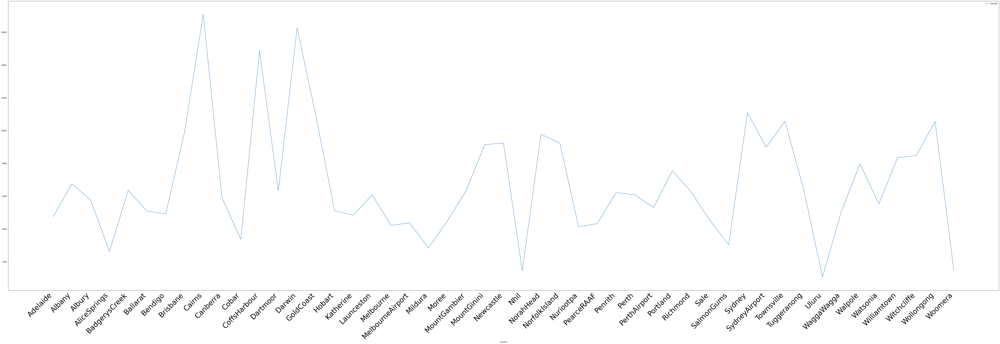

In [54]:
plt.figure(figsize=(100,30))

rainfallByLocation = sns.lineplot(data=table)

plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize='40'  
)

**Question #5:** 

What area recorded the minimum and maximum of the temperature and rainfall readings. This can help predict if similar weather conditions, would result in rainfall for the next day? 

While nothing is 100% predictable below compares similar weather conditions to make an educated hypothesis about rainfall based on weather conditions

In [55]:
#In order to simplify stats, we won't use two seperate readings at 9am and 3 pm but use the min and max
min_temp = min(df["MinTemp"])
max_temp = max(df["MaxTemp"])
max_rain = max(df["Rainfall"])
min_rain = min(df["Rainfall"])

print(min_temp, max_temp, max_rain, min_rain)

-8.5 48.1 371.0 0.0


In [56]:
#highest minimum temp
max(df["MinTemp"])

33.9

In [57]:
#Lowest max temp
min(df["MaxTemp"])

-4.8

In [58]:
#Printings of the Min and Max of Temperature and Rainfall
print("Minimum temperature ever recorded:",min_temp)
print("Maximum temperature ever recorded:",max_temp)
print("Maximum rainfall ever recorded:",max_rain)
print("Minimum rainfall ever recorded:",min_rain)


Minimum temperature ever recorded: -8.5
Maximum temperature ever recorded: 48.1
Maximum rainfall ever recorded: 371.0
Minimum rainfall ever recorded: 0.0


In [59]:
#Conditions surrounding the max temp and where it was recorded
df.loc[df["MaxTemp"] == max_temp]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
103729,2011-01-25,Woomera,25.1,48.1,0.0,22.4,12.8,WSW,85.0,NNE,NW,37.0,43.0,21.0,7.0,1003.4,1000.4,3.0,2.0,33.2,46.1,No,0.0,No


In [60]:
#Conditions surrounding the min temp and where it was recorded
df.loc[df["MinTemp"] == min_temp]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
50958,2009-06-11,MountGinini,-8.5,0.6,1.0,NaN,NaN,S,31.0,WNW,SW,20.0,15.0,47.0,72.0,NaN,NaN,NaN,NaN,-0.9,-0.4,No,0.0,No


**Findings**
The highest recorded amount of Rainfall occurred in Coffs Harbour, Australia (2009). On the day it took place, a high humidity level was recorded throughout the day and the area experianced a significant amount of cloud cover. These elements could be used to predict rain in the future. If a day experiances high levels of humidity and cloud cover, rain has a high probability of occuring. 


In [61]:
#The maximum amount of rainfall recorded occured in Coffs Harbour, Australia
df.loc[df["Rainfall"] == max_rain]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
9236,2009-11-07,CoffsHarbour,17.4,23.1,371.0,NaN,3.5,NaN,NaN,SW,S,13.0,19.0,93.0,81.0,1026.6,1025.9,8.0,5.0,18.6,22.0,Yes,4.8,Yes


Listed below are recordings with minimal rainfall. Each day experienced low humidity and minimal cloud cover and therefore, it would be educated to assume, that with similar conditions, rain is less likely to occur.

In [62]:
#Conditions surrounding the min Rainfall and where it was recorded
df.loc[df["Rainfall"] == min_rain]